In [7]:
# Load model directly
from transformers import AutoImageProcessor, AutoModelForObjectDetection
import torch
from PIL import Image
from pathlib import Path

model_dir = "./detr-resnet-50"
# processor = AutoImageProcessor.from_pretrained("facebook/detr-resnet-50")
# model = AutoModelForObjectDetection.from_pretrained("facebook/detr-resnet-50")
# model.save_pretrained(model_dir)
# processor.save_pretrained(model_dir)
processor = AutoImageProcessor.from_pretrained(model_dir)
model = AutoModelForObjectDetection.from_pretrained(model_dir)

In [25]:
Image.registered_extensions()

{'.bmp': 'BMP',
 '.dib': 'DIB',
 '.gif': 'GIF',
 '.jfif': 'JPEG',
 '.jpe': 'JPEG',
 '.jpg': 'JPEG',
 '.jpeg': 'JPEG',
 '.pbm': 'PPM',
 '.pgm': 'PPM',
 '.ppm': 'PPM',
 '.pnm': 'PPM',
 '.pfm': 'PPM',
 '.png': 'PNG',
 '.apng': 'PNG',
 '.tif': 'TIFF',
 '.tiff': 'TIFF',
 '.blp': 'BLP',
 '.bufr': 'BUFR',
 '.cur': 'CUR',
 '.pcx': 'PCX',
 '.dcx': 'DCX',
 '.dds': 'DDS',
 '.ps': 'EPS',
 '.eps': 'EPS',
 '.fit': 'FITS',
 '.fits': 'FITS',
 '.fli': 'FLI',
 '.flc': 'FLI',
 '.ftc': 'FTEX',
 '.ftu': 'FTEX',
 '.gbr': 'GBR',
 '.grib': 'GRIB',
 '.h5': 'HDF5',
 '.hdf': 'HDF5',
 '.jp2': 'JPEG2000',
 '.j2k': 'JPEG2000',
 '.jpc': 'JPEG2000',
 '.jpf': 'JPEG2000',
 '.jpx': 'JPEG2000',
 '.j2c': 'JPEG2000',
 '.icns': 'ICNS',
 '.ico': 'ICO',
 '.im': 'IM',
 '.iim': 'IPTC',
 '.mpg': 'MPEG',
 '.mpeg': 'MPEG',
 '.mpo': 'MPO',
 '.msp': 'MSP',
 '.palm': 'PALM',
 '.pcd': 'PCD',
 '.pdf': 'PDF',
 '.pxr': 'PIXAR',
 '.psd': 'PSD',
 '.qoi': 'QOI',
 '.bw': 'SGI',
 '.rgb': 'SGI',
 '.rgba': 'SGI',
 '.sgi': 'SGI',
 '.ras': 'SUN',

In [4]:
model_dir = "./detr-resnet-50"
model.save_pretrained(model_dir)
processor.save_pretrained(model_dir)

['./detr-resnet-50/preprocessor_config.json']

In [21]:
def tag_image(image_path:str, model, processor, tag='train'):
    label_codes = {v:k for k,v in model.config.to_dict()["id2label"].items()}
    if tag not in label_codes:
        raise ValueError(f"{tag} not found in model labels. Allowed model labels are: {list(label_codes.keys())}")
    with Image.open(image_path) as image:
        inputs = processor(images=image, return_tensors="pt")
        outputs = model(**inputs)
        target_sizes = torch.tensor([image.size[::-1]])
        results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.9)[0]
    label_id = label_codes[tag]
    label_detected = label_id in results['labels']
    print(f"{tag+'   ' if label_detected else 'no '+tag} in {image_path} ")
    


In [48]:
def tag_image_object(image_obj, model, processor, tag='train'):
    label_codes = {v:k for k,v in model.config.to_dict()["id2label"].items()}
    if tag not in label_codes:
        raise ValueError(f"{tag} not found in model labels. Allowed model labels are: {list(label_codes.keys())}")
    inputs = processor(images=image_obj, return_tensors="pt")
    outputs = model(**inputs)
    target_sizes = torch.tensor([image_obj.size[::-1]])
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.9)[0]
    label_id = label_codes[tag]
    label_detected = label_id in results['labels']
    


In [49]:
im = Image.open(image)

In [54]:
%%timeit 10
im = Image.open(image)
im
# tag_image_object(im, model, processor, tag='train')

111 µs ± 1.9 µs per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [22]:
tag_image("data/5M1A8902.JPG", model, processor, tag='train')

train    in data/5M1A8902.JPG 


In [38]:
%%time
a = 18888**18888

CPU times: user 13.4 ms, sys: 0 ns, total: 13.4 ms
Wall time: 12.7 ms


In [39]:
%%time
# Specify the directory
directory = Path("data")/"CARD 1/"
extensions = Image.registered_extensions()
# List files with a specific extension (e.g., .jpg)
image_files = [file for file in directory.iterdir() if file.suffix.lower() in extensions]

# Example usage
for image in image_files:
    tag_image(image, model, processor, tag='train')


train    in data/CARD 1/5M1A9644.JPG 
no train in data/CARD 1/5M1A9310.JPG 
train    in data/CARD 1/5M1A9932.JPG 
no train in data/CARD 1/5M1A9902.JPG 
no train in data/CARD 1/5M1A9105.JPG 
train    in data/CARD 1/5M1A9666.JPG 
no train in data/CARD 1/5M1A9694.JPG 
train    in data/CARD 1/5M1A9660.JPG 
train    in data/CARD 1/5M1A9716.JPG 
train    in data/CARD 1/5M1A9908.JPG 
no train in data/CARD 1/5M1A8896.JPG 
train    in data/CARD 1/5M1A9273.JPG 
no train in data/CARD 1/5M1A9218.JPG 
no train in data/CARD 1/5M1A9359.JPG 
train    in data/CARD 1/5M1A9446.JPG 
no train in data/CARD 1/5M1A8981.JPG 
no train in data/CARD 1/5M1A9974.JPG 
train    in data/CARD 1/5M1A8892.JPG 
train    in data/CARD 1/5M1A9028.JPG 
train    in data/CARD 1/5M1A8900.JPG 
train    in data/CARD 1/5M1A9793.JPG 
no train in data/CARD 1/5M1A9872.JPG 
no train in data/CARD 1/5M1A9116.JPG 
train    in data/CARD 1/5M1A9085.JPG 
train    in data/CARD 1/5M1A9385.JPG 
train    in data/CARD 1/5M1A9888.JPG 
no train in 

In [40]:
len(image_files)

1131

In [56]:
46*60/1131

2.440318302387268

In [10]:
image = Image.open("data/5M1A8902.JPG")

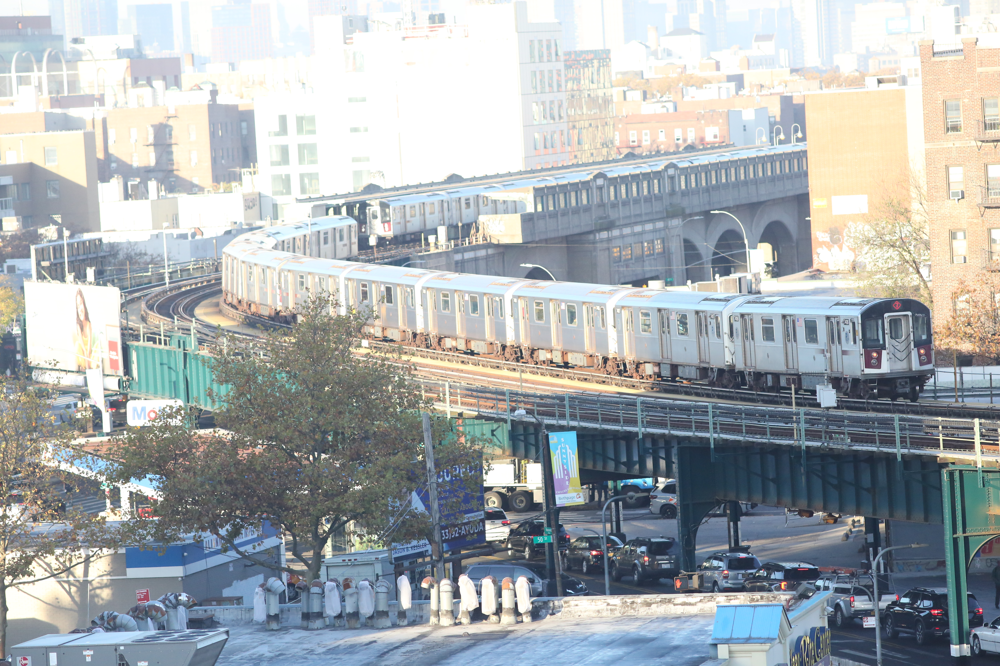

In [11]:
image

In [12]:
inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)

In [13]:
target_sizes = torch.tensor([image.size[::-1]])
results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.9)[0]


In [16]:
7 in results['labels']

True

In [10]:
for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
    box = [round(i, 2) for i in box.tolist()]
    print(
            f"Detected {model.config.id2label[label.item()]} with confidence "
            f"{round(score.item(), 3)} at location {box}"
    )

Detected car with confidence 0.931 at location [3539.17, 2761.46, 3805.5, 2920.21]
Detected car with confidence 0.964 at location [4721.93, 3341.29, 5088.36, 3640.02]
Detected car with confidence 0.969 at location [4328.9, 3235.79, 4752.44, 3427.36]
Detected car with confidence 0.991 at location [3741.88, 2771.5, 3914.24, 2987.92]
Detected car with confidence 0.976 at location [3516.72, 3095.77, 3916.36, 3383.35]
Detected train with confidence 0.998 at location [1254.25, 1303.69, 5396.29, 2330.68]
Detected car with confidence 0.939 at location [4002.36, 3179.25, 4411.37, 3427.14]
Detected car with confidence 0.94 at location [5060.27, 3394.23, 5530.52, 3725.17]
Detected car with confidence 0.98 at location [2779.53, 2909.8, 2943.5, 3166.2]
Detected car with confidence 0.978 at location [5581.09, 3533.62, 5760.25, 3777.97]
Detected car with confidence 0.961 at location [3227.24, 3058.8, 3617.84, 3314.51]
Detected car with confidence 0.942 at location [3249.26, 3064.23, 3628.02, 3322.61]

In [21]:
7 in results["labels"] 

True

In [24]:
72*1.68

120.96

In [9]:
label_codes = {v:k for k,v in model.config.to_dict()["id2label"].items()}
print("train" in label_codes)
label_codes

True


{'N/A': 0,
 'person': 1,
 'bicycle': 2,
 'car': 3,
 'motorcycle': 4,
 'airplane': 5,
 'bus': 6,
 'train': 7,
 'truck': 8,
 'boat': 9,
 'traffic light': 10,
 'fire hydrant': 11,
 'street sign': 12,
 'stop sign': 13,
 'parking meter': 14,
 'bench': 15,
 'bird': 16,
 'cat': 17,
 'dog': 18,
 'horse': 19,
 'sheep': 20,
 'cow': 21,
 'elephant': 22,
 'bear': 23,
 'zebra': 24,
 'giraffe': 25,
 'hat': 26,
 'backpack': 27,
 'umbrella': 28,
 'shoe': 29,
 'eye glasses': 30,
 'handbag': 31,
 'tie': 32,
 'suitcase': 33,
 'frisbee': 34,
 'skis': 35,
 'snowboard': 36,
 'sports ball': 37,
 'kite': 38,
 'baseball bat': 39,
 'baseball glove': 40,
 'skateboard': 41,
 'surfboard': 42,
 'tennis racket': 43,
 'bottle': 44,
 'plate': 45,
 'wine glass': 46,
 'cup': 47,
 'fork': 48,
 'knife': 49,
 'spoon': 50,
 'bowl': 51,
 'banana': 52,
 'apple': 53,
 'sandwich': 54,
 'orange': 55,
 'broccoli': 56,
 'carrot': 57,
 'hot dog': 58,
 'pizza': 59,
 'donut': 60,
 'cake': 61,
 'chair': 62,
 'couch': 63,
 'potted plan

In [11]:
results

{'scores': tensor([0.9314, 0.9640, 0.9692, 0.9914, 0.9761, 0.9982, 0.9390, 0.9404, 0.9797,
         0.9785, 0.9607, 0.9421, 0.9901], grad_fn=<IndexBackward0>),
 'labels': tensor([3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3]),
 'boxes': tensor([[3539.1697, 2761.4578, 3805.5037, 2920.2061],
         [4721.9292, 3341.2922, 5088.3555, 3640.0249],
         [4328.8970, 3235.7871, 4752.4399, 3427.3628],
         [3741.8794, 2771.5012, 3914.2427, 2987.9182],
         [3516.7200, 3095.7676, 3916.3572, 3383.3479],
         [1254.2457, 1303.6879, 5396.2920, 2330.6780],
         [4002.3557, 3179.2485, 4411.3696, 3427.1399],
         [5060.2695, 3394.2324, 5530.5195, 3725.1663],
         [2779.5327, 2909.8035, 2943.4983, 3166.2029],
         [5581.0947, 3533.6194, 5760.2549, 3777.9729],
         [3227.2429, 3058.7966, 3617.8425, 3314.5125],
         [3249.2625, 3064.2283, 3628.0237, 3322.6062],
         [2655.7776, 3215.6006, 3393.5996, 3503.4209]],
        grad_fn=<IndexBackward0>)}

In [3]:
import tkinter as tk

In [2]:
import platform
print(platform.python_version())


3.10.15
